
#Imports e conexão com o Drive


In [ ]:
from google.colab import drive
import os
import urllib.request
import os
from PIL import Image,ImageStat
import numpy as np
import matplotlib.pyplot as plt
import torchvision.models as models
import torchvision
import torch
import torch.nn as nn
from torch.utils.data import  DataLoader
import torchvision.transforms as transforms
import json
from torch import optim
import sklearn.metrics as metrics
import torch
from torchvision import transforms, datasets
from sklearn.model_selection import train_test_split
!pip install scikit-learn
import matplotlib.pyplot as plt
import numpy as np
from sklearn import metrics

In [ ]:
main_dir = "/content/drive/MyDrive/trabia"

In [ ]:
ls

 best_model_1.pth   best_model_2.pth   colheres/  'Colher-Mesa-493 (1).jpg'   facas/


In [ ]:
from google.colab import drive
drive.mount("/content/drive", force_remount=True)

Mounted at /content/drive


# Finetunning nos modelos pré-treinados

In [ ]:
model_1 = models.mobilenet_v3_small(pretrained=True)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=MobileNet_V3_Small_Weights.IMAGENET1K_V1`. You can also use `weights=MobileNet_V3_Small_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [ ]:
model_1.classifier[3] = nn.Linear(1024, 2)

In [ ]:
model_2 = models.googlenet(pretrained=True)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [ ]:
model_2.fc=nn.Linear(1024, 2)

#Construção do Dataset

In [ ]:
os.chdir(main_dir)

In [ ]:
def image_loader(img):
    return Image.open(img).convert("RGB")

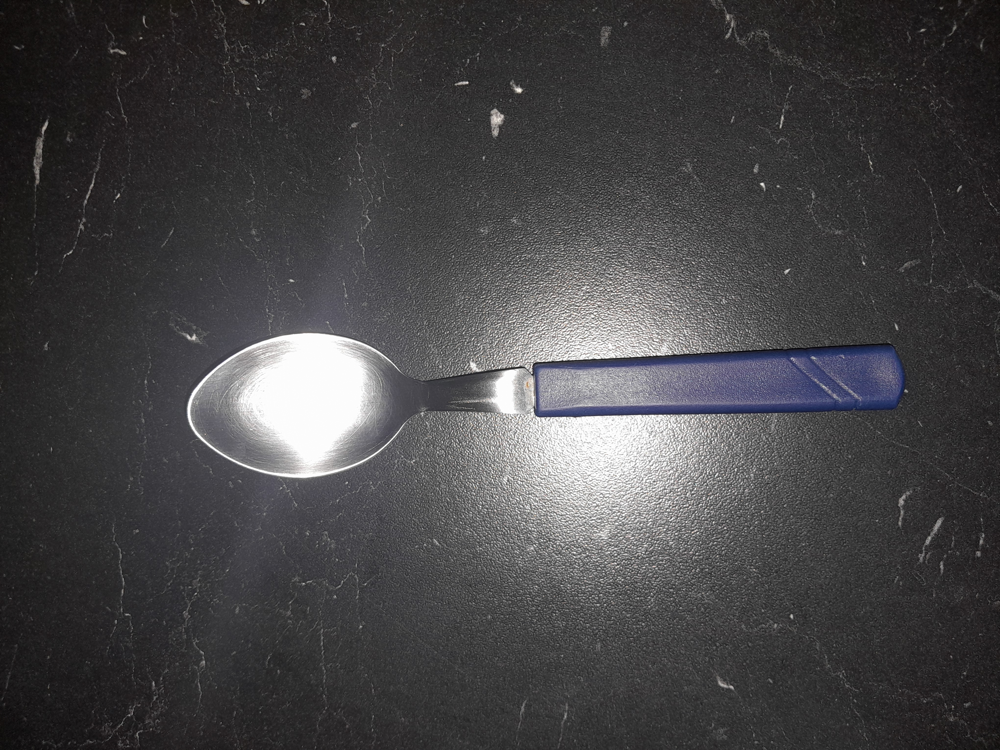

In [ ]:
img = image_loader('./colheres/20241029_142907.jpg')
img

In [ ]:
# Define transformations to apply to the images
transform = transforms.Compose([
    transforms.Resize((256, 256)),  # Resize images to 256x256
    transforms.CenterCrop(224),     # Crop the center 224x224 region
    transforms.ToTensor(),           # Convert images to tensors
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalize the images
])

# Create an ImageFolder dataset
image_dataset = datasets.ImageFolder(root=main_dir, transform=transform)

In [ ]:
x,y = next(iter(image_dataset))

In [ ]:
dir(image_dataset)

['__add__',
 '__annotations__',
 '__class__',
 '__class_getitem__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getitem__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__len__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__orig_bases__',
 '__parameters__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__slots__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_format_transform_repr',
 '_is_protocol',
 '_repr_indent',
 'class_to_idx',
 'classes',
 'extensions',
 'extra_repr',
 'find_classes',
 'imgs',
 'loader',
 'make_dataset',
 'root',
 'samples',
 'target_transform',
 'targets',
 'transform',
 'transforms']

In [ ]:
image_dataset.classes

['colheres', 'facas']

In [ ]:
image_dataset.class_to_idx

{'colheres': 0, 'facas': 1}

In [ ]:
dataset = image_dataset

In [ ]:
len(dataset)

411

In [ ]:
img_tensor = transform(img)
img_tensor.shape

torch.Size([3, 224, 224])

In [ ]:
np.unique(dataset.targets,return_counts=True)

(array([0, 1]), array([210, 201]))

In [ ]:
dataset.targets = torch.tensor(dataset.targets)

In [ ]:
bs = 512
train_idx, temp_idx = train_test_split(np.arange(len(dataset)),test_size=0.3,shuffle=True,stratify=dataset.targets)
valid_idx, test_idx = train_test_split(temp_idx,test_size=0.5,shuffle=True,stratify=dataset.targets[temp_idx])

train_sampler = torch.utils.data.SubsetRandomSampler(train_idx)
valid_sampler = torch.utils.data.SubsetRandomSampler(valid_idx)
test_sampler  = torch.utils.data.SubsetRandomSampler(test_idx)

dl_train = torch.utils.data.DataLoader(dataset,batch_size=bs,sampler=train_sampler)
dl_valid = torch.utils.data.DataLoader(dataset,batch_size=bs,sampler=valid_sampler)
dl_test  = torch.utils.data.DataLoader(dataset,batch_size=bs,sampler=test_sampler)

In [ ]:
train_idx.shape

(287,)

In [ ]:
valid_idx.shape

(62,)

In [ ]:
x,y = next(iter(dl_train))

In [ ]:
np.unique(dataset.targets[train_idx],return_counts=True)

(array([0, 1]), array([147, 140]))

In [ ]:
np.unique(dataset.targets[valid_idx],return_counts=True)

(array([0, 1]), array([31, 31]))

In [ ]:
np.unique(dataset.targets[test_idx],return_counts=True)

(array([0, 1]), array([32, 30]))

In [ ]:
loss_train = []
loss_eval  = []

#MobileNet

In [ ]:
device = torch.device('cuda:0') if torch.cuda.is_available() else torch.device('cpu')

In [ ]:
model_1.to(device)

MobileNetV3(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(16, eps=0.001, momentum=0.01, affine=True, track_running_stats=True)
      (2): Hardswish()
    )
    (1): InvertedResidual(
      (block): Sequential(
        (0): Conv2dNormActivation(
          (0): Conv2d(16, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), groups=16, bias=False)
          (1): BatchNorm2d(16, eps=0.001, momentum=0.01, affine=True, track_running_stats=True)
          (2): ReLU(inplace=True)
        )
        (1): SqueezeExcitation(
          (avgpool): AdaptiveAvgPool2d(output_size=1)
          (fc1): Conv2d(16, 8, kernel_size=(1, 1), stride=(1, 1))
          (fc2): Conv2d(8, 16, kernel_size=(1, 1), stride=(1, 1))
          (activation): ReLU()
          (scale_activation): Hardsigmoid()
        )
        (2): Conv2dNormActivation(
          (0): Conv2d(16, 16, kernel_size=(1, 1), 

In [ ]:
x.to(device)

tensor([[[[-1.1075, -1.1075, -1.1418,  ...,  0.2453,  0.1939,  0.2453],
          [-1.0904, -1.0904, -1.1247,  ...,  0.2282,  0.1768,  0.1768],
          [-1.1247, -1.1418, -1.1418,  ...,  0.1768,  0.1254,  0.0912],
          ...,
          [-0.8678, -0.9363, -0.8849,  ..., -1.1760, -1.1932, -1.1932],
          [-0.8678, -0.9020, -0.8849,  ..., -1.1589, -1.1932, -1.1760],
          [-0.8849, -0.9020, -0.8678,  ..., -1.1418, -1.1589, -1.1760]],

         [[-1.0903, -1.0903, -1.1253,  ...,  0.4153,  0.3627,  0.4153],
          [-1.0728, -1.0728, -1.1078,  ...,  0.3978,  0.3452,  0.3452],
          [-1.1078, -1.1253, -1.1253,  ...,  0.3452,  0.2927,  0.2577],
          ...,
          [-0.7577, -0.8277, -0.7927,  ..., -1.2129, -1.2304, -1.2304],
          [-0.7577, -0.8102, -0.7927,  ..., -1.1954, -1.2304, -1.2129],
          [-0.7927, -0.8277, -0.7752,  ..., -1.1604, -1.1954, -1.2129]],

         [[-0.9156, -0.9330, -0.9504,  ...,  0.6182,  0.5659,  0.6008],
          [-0.8981, -0.8981, -

In [ ]:
patience_time = 15

In [ ]:
criterion = nn.CrossEntropyLoss()
opt = optim.SGD(model_1.parameters(),lr=0.01)

In [ ]:
epochs = 100

stop = False
epoch = 0
lowest_loss_eval = 10000
last_best_result = 0
while (not stop):
    #wandb.watch(model)
    model_1.train()
    lloss = []
    for x,y in dl_train:
        x = x.to(device)
        y = y.to(device)
        pred = model_1(x)
        closs = criterion(pred,y)
        closs.backward()
        opt.step()
        opt.zero_grad()
        lloss.append(closs.item())
        #print(closs.item())
    loss_train.append(np.mean(lloss))
    lloss = []
    model_1.eval()
    lres = []
    ytrue = []
    with torch.no_grad():
        for data,y in dl_valid:
            data = data.to(device)

            pred = model_1(data)
            closs = criterion(pred.cpu(),y)
            lloss.append(closs.item())
            res  = pred.argmax(dim=1).cpu().tolist()
            lres += res
            ytrue += y
    avg_loss_eval = np.mean(lloss)
    loss_eval.append(avg_loss_eval)
    #wandb.log({"loss_eval": avg_loss_eval,"loss_train":loss_train[-1]})
    if avg_loss_eval < lowest_loss_eval:
        lowest_loss_eval = avg_loss_eval
        last_best_result = 0
        print("Best model found! saving...")
        actual_state = {'optim':opt.state_dict(),'model':model_1.state_dict(),'epoch':epoch,'loss_train':loss_train,'loss_eval':loss_eval}
        torch.save(actual_state,'best_model_1.pth')
    last_best_result += 1
    if last_best_result > patience_time:
        stop = True
    print("epoch %d loss_train %4.3f loss_eval %4.3f last_best %d"%(epoch,loss_train[-1],loss_eval[-1],last_best_result))
    epoch += 1

Best model found! saving...
epoch 0 loss_train 0.734 loss_eval 0.720 last_best 1
Best model found! saving...
epoch 1 loss_train 0.695 loss_eval 0.692 last_best 1
Best model found! saving...
epoch 2 loss_train 0.658 loss_eval 0.666 last_best 1
Best model found! saving...
epoch 3 loss_train 0.632 loss_eval 0.644 last_best 1
Best model found! saving...
epoch 4 loss_train 0.592 loss_eval 0.624 last_best 1
Best model found! saving...
epoch 5 loss_train 0.575 loss_eval 0.605 last_best 1
Best model found! saving...
epoch 6 loss_train 0.550 loss_eval 0.588 last_best 1
Best model found! saving...
epoch 7 loss_train 0.526 loss_eval 0.572 last_best 1
Best model found! saving...
epoch 8 loss_train 0.504 loss_eval 0.558 last_best 1
Best model found! saving...
epoch 9 loss_train 0.493 loss_eval 0.545 last_best 1
Best model found! saving...
epoch 10 loss_train 0.471 loss_eval 0.533 last_best 1
Best model found! saving...
epoch 11 loss_train 0.455 loss_eval 0.521 last_best 1
Best model found! saving..

KeyboardInterrupt: 

In [ ]:
recover_mobile = torch.load('best_model_1.pth')
model_1.load_state_dict(recover_mobile['model'])

opt = optim.SGD(model_1.parameters(), lr=0.01)  # Use the same lr as before

opt.load_state_dict(recover_mobile['optim'])

loss_train = recover_mobile['loss_train']  # Corrected variable name
loss_eval = recover_mobile['loss_eval']    # Corrected variable name
epoch = recover_mobile['epoch']          # Corrected variable name
l = []
for layer in model_1.children():
    l.append(layer)

<ipython-input-102-b12da774a9f2>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  recover_mobile = torch.load('best_model_1.pth')


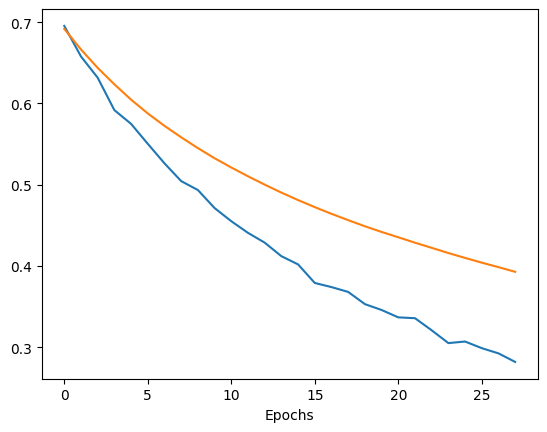

In [ ]:
fig = plt.figure()
plt.plot(loss_train[1:])
plt.plot(loss_eval[1:])
plt.xlabel('Epochs')
plt.show()

In [ ]:
model_1.eval()
lres = []
ytrue = []
with torch.no_grad():
    for data,target in dl_test:
        data = data.to(device)
        pred = model_1(data)
        res  = pred.argmax(dim=1).cpu().tolist()
        lres += res
        ytrue += target

In [ ]:
metrics.confusion_matrix(ytrue,lres)

array([[32,  0],
       [ 2, 28]])

In [ ]:
print(metrics.classification_report(ytrue,lres))


              precision    recall  f1-score   support

           0       0.94      1.00      0.97        32
           1       1.00      0.93      0.97        30

    accuracy                           0.97        62
   macro avg       0.97      0.97      0.97        62
weighted avg       0.97      0.97      0.97        62



# GoogleNET

In [ ]:
model_2.to(device)
criterion = nn.CrossEntropyLoss()
opt = optim.SGD(model_2.parameters(),lr=0.1)

In [ ]:
epochs = 100
loss_train = []
loss_eval  = []
stop = False
epoch = 0
lowest_loss_eval = 10000
last_best_result = 0
while (not stop):
    model_2.train()
    lloss = []
    for x,y in dl_train:
        x = x.to(device)
        y = y.to(device)
        pred = model_2(x)
        closs = criterion(pred,y)
        closs.backward()
        opt.step()
        opt.zero_grad()
        lloss.append(closs.item())
    loss_train.append(np.mean(lloss))
    llos = []
    model_2.eval()
    lres = []
    ytrue = []
    with torch.no_grad():
        for data,y in dl_valid:
            data = data.to(device)
            pred = model_2(data)
            closs = criterion(pred.cpu(),y)
            lloss.append(closs.item())
            res  = pred.argmax(dim=1).cpu().tolist()
            lres += res
            ytrue += y
    avg_loss_eval = np.mean(lloss)
    loss_eval.append(avg_loss_eval)
    if avg_loss_eval < lowest_loss_eval:
        lowest_loss_eval = avg_loss_eval
        last_best_result = 0
        print("Best model found! saving...")
        actual_state = {'model':model_2.state_dict(),'opt':opt.state_dict(),'epoch':epoch,'loss':lowest_loss_eval,'loss_train':loss_train,'loss_eval':loss_eval}
        torch.save(actual_state,'/content/drive/MyDrive/trabia/best_model_2.pth')
    last_best_result += 1
    if last_best_result > 10:
        stop = True
    print("epoch %d loss_train %4.3f loss_eval %4.3f last_best %d"%(epoch,loss_train[-1],loss_eval[-1],last_best_result))
    epoch += 1

Best model found! saving...
epoch 0 loss_train 0.673 loss_eval 0.632 last_best 1
epoch 1 loss_train 0.502 loss_eval 0.753 last_best 2
epoch 2 loss_train 1.121 loss_eval 2.537 last_best 3
epoch 3 loss_train 3.594 loss_eval 2.434 last_best 4
epoch 4 loss_train 1.935 loss_eval 2.866 last_best 5
epoch 5 loss_train 1.973 loss_eval 1.036 last_best 6
Best model found! saving...
epoch 6 loss_train 0.197 loss_eval 0.154 last_best 1
Best model found! saving...
epoch 7 loss_train 0.036 loss_eval 0.061 last_best 1
Best model found! saving...
epoch 8 loss_train 0.025 loss_eval 0.048 last_best 1
Best model found! saving...
epoch 9 loss_train 0.018 loss_eval 0.038 last_best 1
Best model found! saving...
epoch 10 loss_train 0.016 loss_eval 0.034 last_best 1
Best model found! saving...
epoch 11 loss_train 0.014 loss_eval 0.031 last_best 1
Best model found! saving...
epoch 12 loss_train 0.012 loss_eval 0.029 last_best 1
Best model found! saving...
epoch 13 loss_train 0.010 loss_eval 0.027 last_best 1
Be

In [ ]:
recover_googlenet = torch.load('/content/drive/MyDrive/trabia/best_model_2.pth')

<ipython-input-111-ccea49437684>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  recover_googlenet = torch.load('/content/drive/MyDrive/trabia/best_model_2.pth')


In [ ]:
model_2.load_state_dict(recover_googlenet['model'],strict=False)
opt.load_state_dict(recover_googlenet['opt'])
loss_train = recover_googlenet['loss_train']
loss_eval  = recover_googlenet['loss_eval']
stop = False
epoch = recover_googlenet['epoch']
lowest_loss_eval = recover_googlenet['loss']
last_best_result = 0

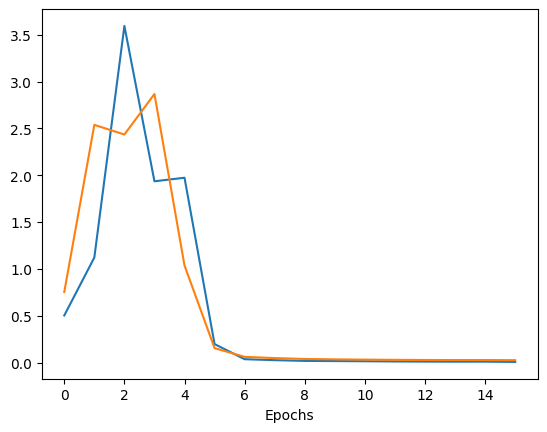

In [ ]:
fig = plt.figure()
plt.plot(loss_train[1:])
plt.plot(loss_eval[1:])
plt.xlabel('Epochs')
plt.show()

In [ ]:
model_2.eval()
lres = []
ytrue = []
with torch.no_grad():
    for data,target in dl_test:
        data = data.to(device)
        pred = model_2(data)
        res  = pred.argmax(dim=1).cpu().tolist()
        lres += res
        ytrue += target

In [ ]:
metrics.confusion_matrix(ytrue,lres)

array([[32,  0],
       [ 1, 29]])

In [ ]:
print(metrics.classification_report(ytrue,lres))

              precision    recall  f1-score   support

           0       0.97      1.00      0.98        32
           1       1.00      0.97      0.98        30

    accuracy                           0.98        62
   macro avg       0.98      0.98      0.98        62
weighted avg       0.98      0.98      0.98        62



#Teste

In [ ]:
import torch
from torchvision import models
from torchvision import transforms
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import classification_report, confusion_matrix
import torch.nn as nn



model_path = 'best_model_2.pth'
state_dict = torch.load(model_path)
model = models.efficientnet_b0(weights=models.EfficientNet_B0_Weights.IMAGENET1K_V1)
model.classifier[1] = nn.Linear(1280, 2)

filtered_state_dict = {k: v for k, v in state_dict.items() if k in model.state_dict()}

model.load_state_dict(filtered_state_dict, strict=False)


model.to(device)
model.eval()

def classify_image(image: Image) -> str:
    """Classifica a imagem e retorna a classe prevista."""
    img_tensor = transform(image).unsqueeze(0).to(device)
    with torch.no_grad():
        output = model(img_tensor)
        predicted_class = output.argmax().item()
    return dataset.classes[predicted_class]


def test_single_image(image_path: str):
    """Carrega uma imagem, realiza a previsão e exibe o resultado."""
    image = Image.open(image_path).convert("RGB")
    predicted_class = classify_image(image)
    plt.imshow(image)
    plt.title(f"Classe Predita: {predicted_class}")
    plt.axis('off')
    plt.show()


test_single_image("/content/drive/MyDrive/trabia/Colher-Mesa-493.jpg")

# Avaliação Completa do Conjunto de Teste
y_true = []
y_pred = []

with torch.no_grad():
    for images, labels in dl_test:
        images = images.to(device)
        outputs = model(images)
        _, predictions = torch.max(outputs, 1)
        y_pred.extend(predictions.cpu().numpy())
        y_true.extend(labels.cpu().numpy())

# Exibir Métricas de Avaliação
print("Relatório de Classificação:")
print(classification_report(y_true, y_pred, target_names=dataset.classes))

print("Matriz de Confusão:")
conf_matrix = confusion_matrix(y_true, y_pred)
print(conf_matrix)

# Visualizar a Matriz de Confusão
import seaborn as sns
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=dataset.classes, yticklabels=dataset.classes)
plt.xlabel("Classe Predita")
plt.ylabel("Classe Verdadeira")
plt.title("Matriz de Confusão")
plt.show()

#Integração com o Telgram

In [ ]:
!pip install python-telegram-bot --upgrade
!pip install python-telegram-bot Pillow

In [ ]:
!pip install python-telegram-bot --upgrade


import telegram
from telegram.ext import ApplicationBuilder, ContextTypes, CommandHandler, MessageHandler, filters
from PIL import Image
import os

TOKEN = '8143236670:AAGMV7i6oF1Hs61H-KEy5fEyThk-z53UlhA'

bot = telegram.Bot(token=TOKEN)


transform = transforms.Compose([
    transforms.Resize((256, 256)),  # Resize images to 256x256
    transforms.CenterCrop(224),     # Crop the center 224x224 region
    transforms.ToTensor(),           # Convert images to tensors
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalize the images
])

def classify_image(update, context):
    chat_id = update.message.chat_id
    file_id = update.message.photo[-1].file_id
    file = bot.get_file(file_id)
    image_path = f'/tmp/{file_id}.jpg'
    file.download(image_path)

    try:
        image = Image.open(image_path).convert("RGB")
        img_tensor = transform(image).unsqueeze(0).to(device)
        with torch.no_grad():
            output = model(img_tensor)
            predicted_class = output.argmax().item()

        class_name = dataset.classes[predicted_class]

        bot.send_message(chat_id=chat_id, text=f"A imagem foi classificada como: {class_name}")
    except Exception as e:
      bot.send_message(chat_id=chat_id, text=f"Erro ao processar a imagem: {e}")
    os.remove(image_path)




image_handler = MessageHandler(filters.PHOTO, classify_image)

async def classify_image(update: Update, context: ContextTypes.DEFAULT_TYPE) -> None:
    chat_id = update.message.chat_id
    file_id = update.message.photo[-1].file_id
    file = await context.bot.get_file(file_id)

    image_path = f'/tmp/{file_id}.jpg'
    await file.download_to_drive(image_path)

    try:
        image = Image.open(image_path).convert("RGB")
        img_tensor = transform(image).unsqueeze(0).to(device)
        with torch.no_grad():
            output = model(img_tensor)
            predicted_class = output.argmax().item()

        class_name = dataset.classes[predicted_class]
        await context.bot.send_message(chat_id=chat_id, text=f"A imagem foi classificada como: {class_name}")
    except Exception as e:
      await context.bot.send_message(chat_id=chat_id, text=f"Erro ao processar a imagem: {e}")

    os.remove(image_path)

def main():
    """Start the bot."""
    application = ApplicationBuilder().token(TOKEN).build()
    application.add_handler(MessageHandler(filters.PHOTO, classify_image))
    application.run_polling()

if __name__ == '__main__':
    main()